# Mann-Kendall Trend Test Analysis

In [3]:
# IMPORTS
import os
import numpy as np
import pandas as pd
import seaborn as sns
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
#import contextily as cx
import requests
import calendar
from importlib import reload

from datetime import datetime, timedelta
from shapely.geometry import Point
from io import StringIO
from mpl_toolkits.axes_grid1 import make_axes_locatable

# USGS Data retreival tool
from dataretrieval import nwis, utils, codes

# Custom modules are imported in multiple locations to faciliate easy reloading when edits are made to their respective files
import Src.classes as cl
import Src.func_ko as fn
reload(cl)
reload(fn)

<module 'Src.func_ko' from 'C:\\Users\\kondr\\Documents\\GitHub\\HighMagFlows_EPA_Project\\Src\\func_ko.py'>

### Import national validity and mk dfs

In [4]:
# All gages - National metrics dfs
data_paths = {
    '30_90': 'Prelim_Data/National_Metrics/National_Metrics_30_90.xlsx',
        '50_90': 'Prelim_Data/National_Metrics/National_Metrics_50_90.xlsx',
    '30_95': 'Prelim_Data/National_Metrics/National_Metrics_30_95.xlsx',
    '50_95': 'Prelim_Data/National_Metrics/National_Metrics_50_95.xlsx'    
}

dfs_metrics = {key: pd.read_excel(path, sheet_name='site_metrics') for key, path in data_paths.items()}

In [5]:
# Valid gages - National metrics dfs
date_ranges = ['30', '50']
percentiles = ['90', '95']
dfs_valid = {}
for date_range in date_ranges:
    for percentile in percentiles: 
        dfs_valid[f'{date_range}_{percentile}'] = dfs_metrics[f'{date_range}_{percentile}'][dfs_metrics[f'{date_range}_{percentile}']['valid'] == True]

In [10]:
# All gages - MK dfs
sheet_names = ['mk_magnitude', 'mk_duration','mk_intra_annual']
dfs_mk = {}
for sheet_name in sheet_names:
    dfs_mk[sheet_name] = {key: pd.read_excel(path, sheet_name=sheet_name) for key, path in data_paths.items()}

In [11]:
# Valid gages - MK dfs
dfs_mk_valid = {}
for sheet_name in sheet_names:
    dfs_mk_temp = {}
    for date_range in date_ranges:
        for percentile in percentiles: 
            dfs_mk_temp[f'{date_range}_{percentile}'] = pd.merge(dfs_mk[sheet_name][f'{date_range}_{percentile}'],
                                                dfs_valid[f'{date_range}_{percentile}'], on='site_no', how='inner', suffixes=('_mk', '_valid'))
    dfs_mk_valid[sheet_name] = dfs_mk_temp

### Generate table of sites with increasing or decreasing trends (need to fix)

In [12]:
# sheet_names = ['mk_magnitude', 'mk_duration','mk_intra_annual']
# zd_sheets = {}
# cont_sheets = {}
# df_mk_trends = {}

# for sheet_name in sheet_names:
#     mkdataset = f'{aquifer}_{date_range}_{percentile}.xlsx'
#     mkdatapath = f'../results/site_metrics/{aquifer}/{mkdataset}'
#     df = pd.read_excel(io=mkdatapath, sheet_name=sheet_name)
#     zd_sheets[sheet_name] = df.loc[(df['trend_zd'] == 'increasing') | (df['trend_zd'] == 'decreasing')]
#     cont_sheets[sheet_name] = df.loc[(df['trend'] == 'increasing') | (df['trend'] == 'decreasing')]
#     #print(zd_sheets[sheet_name])
# df_mk_trends['zd'] = zd_sheets
# df_mk_trends['cont'] = cont_sheets
# #df_mk_trends['zd'] = df.loc[(df['trend_zd'] == 'increasing') | (df['trend_zd'] == 'decreasing')]
# #df_mk_trends['cont'] = df.loc[(df['trend'] == 'increasing') | (df['trend'] == 'decreasing')]
# df_mk_trends['zd']['mk_magnitude']
# #df_mk_trends['cont']['mk_magnitude']

### Stacked bar plots of Mann-Kendall trend occurances

In [28]:
# Mann-Kendall
#datapath = f'Prelim_Data/National_Metrics/National_Metrics_{range}_{quantile}.xlsx'
#df_30_90 = pd.read_excel(datapath, sheet_name='site_metrics')

sheet_names = ['mk_magnitude', 'mk_duration','mk_intra_annual']
plot_names = {'mk_magnitude':'Annual Magnitude', 'mk_duration':'Annual Duration','mk_intra_annual':'Intra-Annual Frequency'}

def count_valid_trends(sheet_name, gages_included):
    '''Plot stacked bar plots that show number of sites with increasing, decreasing, or no trend'''
    
    date_ranges = ['30', '50']
    percentiles = ['90', '95']
    title_names = {'all_gages': 'All Gages', 'valid_gages': 'Valid Gages',}
    
    i = 0
    fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(20, 5))
    
    trend_dict = {}
    for date_range in date_ranges:
        
        trend_dict_perc = {}
        for percentile in percentiles:
    
            # Load data sets based on date_range and percentile            
            if gages_included == 'valid_gages':
                df = dfs_mk_valid[sheet_name][f'{date_range}_{percentile}']
            elif gages_included == 'all_gages':
                df = dfs_mk[sheet_name][f'{date_range}_{percentile}']

            col_names = ['trend_zd', 'trend']
            x_labels = ['Zero-Deflated', 'Continuous']

            # Initialize arrays for each trend category
            no_trend = np.zeros(2)
            incr_trend = np.zeros(2)
            decr_trend = np.zeros(2)    

            # Count occurrences of each trend category in each column
            for col, x_label in zip(col_names, x_labels):
                if 'no trend' in df[col].value_counts():
                    no_trend[x_labels.index(x_label)] = df[col].value_counts()['no trend']
                if 'increasing' in df[col].value_counts():
                    incr_trend[x_labels.index(x_label)] = df[col].value_counts()['increasing']
                if 'decreasing' in df[col].value_counts():
                    decr_trend[x_labels.index(x_label)] = df[col].value_counts()['decreasing']

            # Plotting
            ax[i].bar(x_labels, no_trend, color='gold', alpha=0.4)
            ax[i].bar(x_labels, incr_trend, bottom=no_trend, color='blue', alpha=0.8)
            ax[i].bar(x_labels, decr_trend, bottom=no_trend+incr_trend, color='red', alpha=0.8)
            ax[i].set_title(f'Date Range: {date_range}, Percentile: {percentile}', fontsize=14)
            if i == 0:
                ax[i].set_ylabel('No. of Sites', fontsize=14)
                
            # Change tick mark sizes
            ax[i].tick_params(axis='x', labelsize=14) 
            ax[i].tick_params(axis='y', labelsize=14)
            
            # Create dictionary with occurrences of each trend category
            trend_dict_perc[percentile] = {'no_trend': no_trend, 'incr_trend': incr_trend, 'decr_trend': decr_trend}
        
            i += 1
        trend_dict[date_range] = trend_dict_perc
            
    plt.legend(['No trend', 'Increasing', 'Decreasing'])
    plt.suptitle(f'Significant Mann-Kendall Trends ({title_names[gages_included]}) \n {plot_names[sheet_name]}', y = 1.05, fontsize=14)
    plt.tight_layout()
    
    plt.savefig(f'Saved_Visuals/MK_test/MKT_count_{gages_included}_{sheet_name}.png', bbox_inches='tight')
#     img_str = f'../../results/saved_visuals/mkt_barplots_{aquifer}_{sheet_name}.png'
#     if os.path.exists(img_str) and overwrite:
#         plt.savefig(f'../../results/saved_visuals/mkt_barplots_{aquifer}_{sheet_name}.png')
#     elif not os.path.exists(img_str):
#         plt.savefig(f'../../results/saved_visuals/mkt_barplots_{aquifer}_{sheet_name}.png')

    plt.show()
    return trend_dict

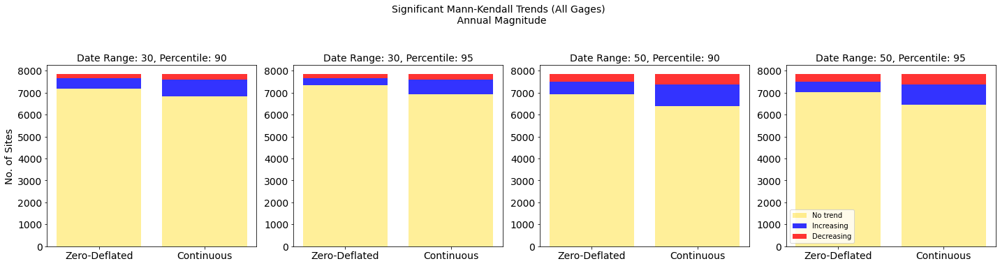

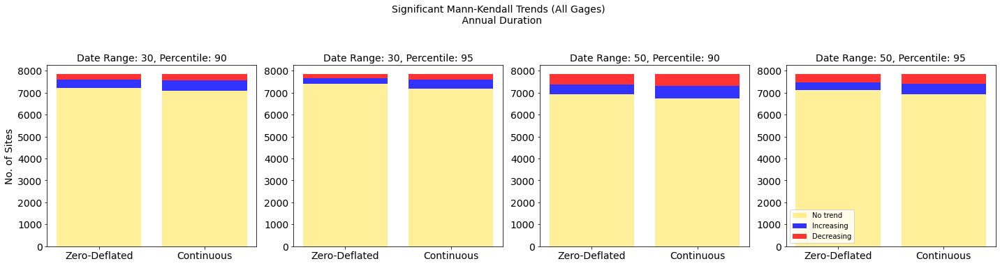

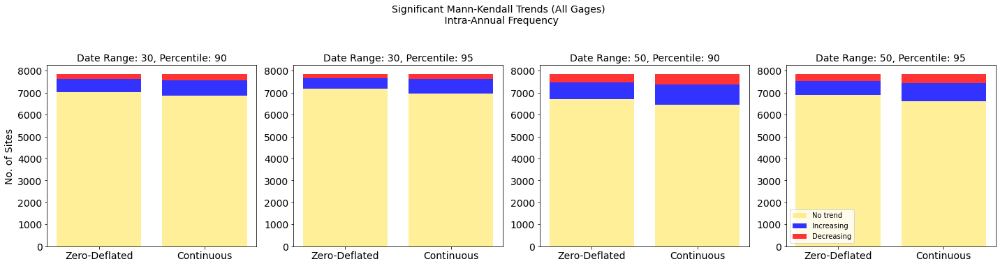

In [29]:
mk_count_all_gages = {}
for sheet_name in sheet_names:
    mk_count_all_gages[sheet_name] = count_valid_trends(sheet_name, 'all_gages')

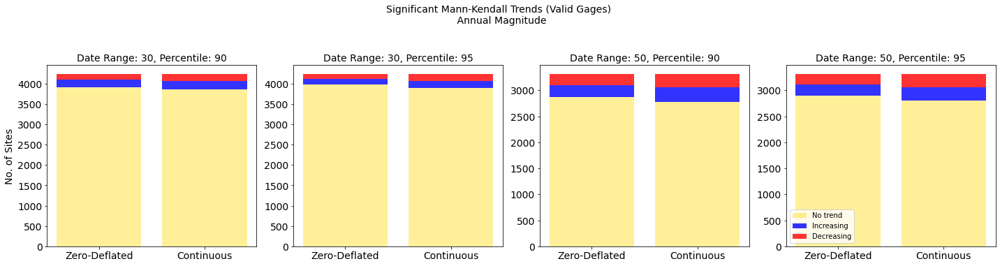

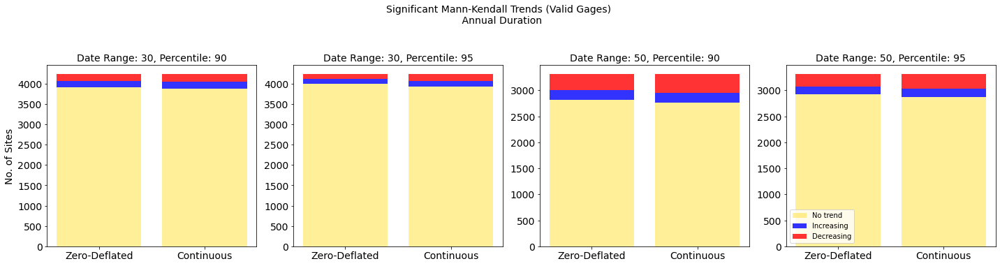

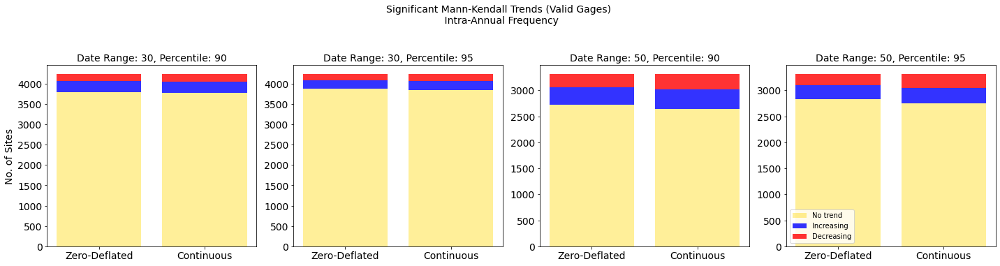

In [30]:
mk_count_valid_gages = {}
for sheet_name in sheet_names:
    mk_count_valid_gages[sheet_name] = count_valid_trends(sheet_name, 'valid_gages')

In [20]:
# Count ofs gages in bar plots for each trend category
mk_count_all_gages
mk_count_valid_gages

{'mk_magnitude': {'30': {'90': {'no_trend': array([3913., 3866.]),
    'incr_trend': array([185., 199.]),
    'decr_trend': array([143., 176.])},
   '95': {'no_trend': array([3979., 3885.]),
    'incr_trend': array([144., 186.]),
    'decr_trend': array([118., 170.])}},
  '50': {'90': {'no_trend': array([2871., 2782.]),
    'incr_trend': array([226., 275.]),
    'decr_trend': array([219., 259.])},
   '95': {'no_trend': array([2890., 2801.]),
    'incr_trend': array([217., 255.]),
    'decr_trend': array([209., 260.])}}},
 'mk_duration': {'30': {'90': {'no_trend': array([3913., 3869.]),
    'incr_trend': array([160., 180.]),
    'decr_trend': array([168., 192.])},
   '95': {'no_trend': array([3994., 3921.]),
    'incr_trend': array([115., 146.]),
    'decr_trend': array([132., 174.])}},
  '50': {'90': {'no_trend': array([2816., 2757.]),
    'incr_trend': array([184., 198.]),
    'decr_trend': array([316., 361.])},
   '95': {'no_trend': array([2917., 2872.]),
    'incr_trend': array([151

### Maps of significant Mann-Kendall trends

In [24]:
trend_options = ['no trend', 'increasing', 'decreasing']

def plot_mkt_trend(sheet_name, gages_included):
    '''Plot map of stream gages and corresponding trend (increasing, decreasing, no trend) for each aquifer. '''
    
    trend_options = ['no trend', 'increasing', 'decreasing']
    trend_series = ['trend_zd', 'trend']
    trend_label = ['Zero-deflated', 'Continuous']
    plot_names = {'mk_magnitude':'Annual Magnitude', 'mk_duration':'Annual Duration','mk_intra_annual':'Intra-Annual Frequency'}
    
    date_ranges = ['30', '50']
    percentiles = ['90', '95']
    
    fig, ax = plt.subplots(nrows=2, ncols=4, figsize=(30, 15))
    
    i = 0
    for trend in trend_series:
        j = 0
        for date_range in date_ranges:
            #j = 0
            for percentile in percentiles:
                
                # Load data sets based on date_range and percentile
                if gages_included == 'valid_gages':
                    df = dfs_mk_valid[sheet_name][f'{date_range}_{percentile}']
                elif gages_included == 'all_gages':
                    df = dfs_mk[sheet_name][f'{date_range}_{percentile}']

                plt.suptitle(f'Significant Mann-Kendall Trends \n {plot_names[sheet_name]}', fontsize=20)
                             
                # State plot
                lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
                lower48 = lower48.to_crs(epsg=4269)
                lower48.plot(ax=ax[i,j], edgecolor='blue', alpha = 0.2, legend=True) 
                
                # Custom colormap and marker styles for gages
                colors = {'increasing': 'blue', 'decreasing': 'red', 'no trend': 'yellow'}
                markers = {'increasing': '^', 'decreasing': 'v', 'no trend': 'o'}
                marker_sizes = {'increasing': 150, 'decreasing': 150, 'no trend': 50}
                
                # Gages plot, with points marked by MK trend
                lat = df['dec_lat_va_valid'].tolist()
                long = df['dec_long_va_valid'].tolist()
                geometry = [Point(xy) for xy in zip(long, lat)]
                geo_df = gpd.GeoDataFrame(geometry=geometry)
                
                for trend_opt in trend_options:
                    df_subset = df[df[trend] == trend_opt]
                    geo_subset = geo_df.iloc[df_subset.index]
                    #print(colors[trend_opt]); color=str(colors[trend_opt]),
                    bx = geo_subset.plot(ax=ax[i,j], color=colors[trend_opt], marker=markers[trend_opt], markersize=marker_sizes[trend_opt], 
                                         label=marker_sizes[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)

                ax[i,j].set_title(f'Date Range: {date_range}, Percentile:{percentile} \n {trend_label[i]}', fontsize=20)
               # if j == 0:
               #     ax[i,j].set_ylabel(f'{trend_series}')
                ax[i,j].margins(0, tight=True)
                ax[i,j].set_axis_off()
                             
                j += 1
            #i += 1
        i += 1

#         img_str = f'../saved_visuals/{dataset[:-4]}.png'
#         if os.path.exists(img_str) and overwrite:
#             plt.savefig(f'../saved_visuals/{aquifer}_{sheet_name}.png')
#         elif not os.path.exists(img_str):
#             plt.savefig(f'../saved_visuals/{aquifer}_{sheet_name}.png')
    
    plt.legend()
    plt.tight_layout()
    plt.savefig(f'Saved_Visuals/MK_test/trend_map_{percentile}_{date_range}_{sheet_name}_{gages_included}_small.png', bbox_inches='tight')
    plt.show()
    return

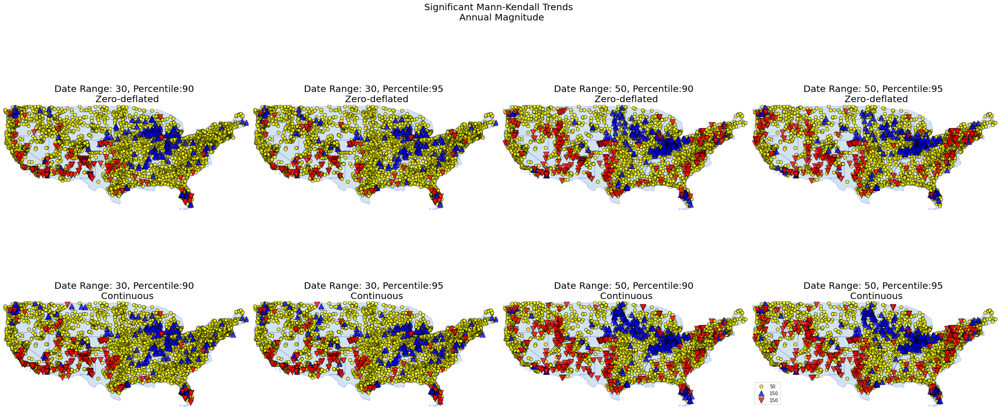

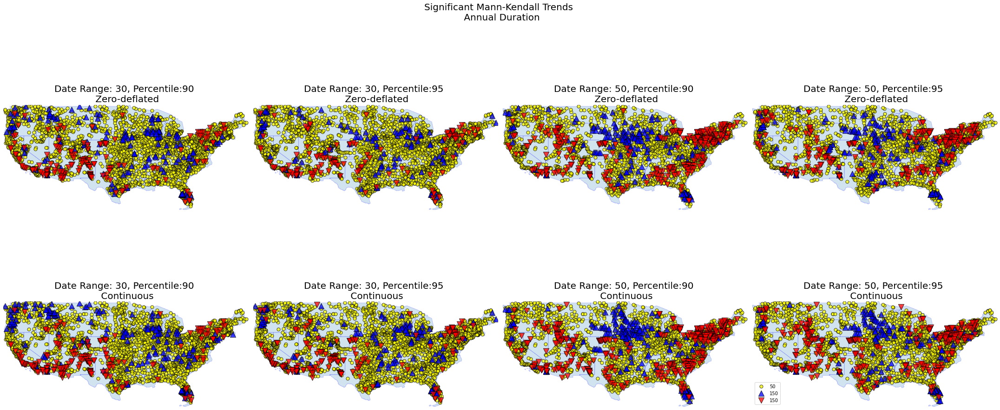

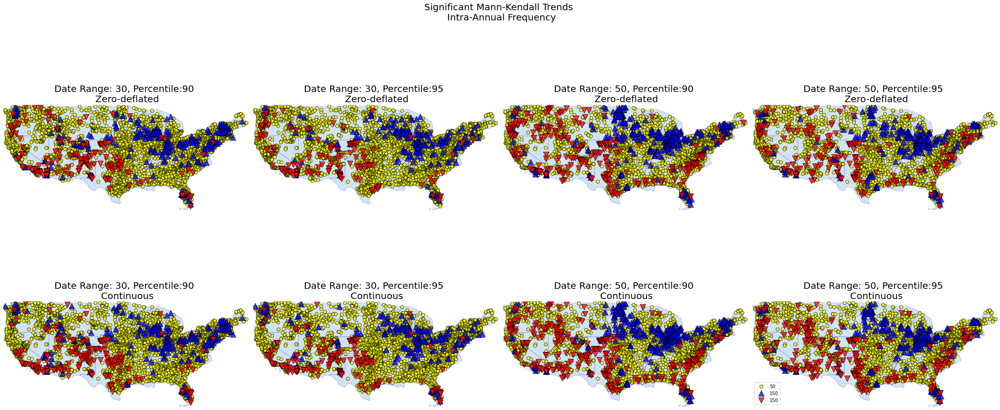

In [25]:
sheet_names = ['mk_magnitude', 'mk_duration','mk_intra_annual']
for sheet_name in sheet_names:
    plot_mkt_trend(sheet_name, 'valid_gages')

In [26]:
trend_options = ['no trend', 'increasing', 'decreasing']

def plot_mkt_trend(sheet_name, gages_included, date_range, percentile):
    '''Plot map of stream gages and corresponding trend (increasing, decreasing, no trend) for each aquifer. '''
    
    trend_options = ['no trend', 'increasing', 'decreasing']
    trend_series = ['trend_zd', 'trend']
    trend_labels = {'trend_zd':'Zero-deflated', 'trend':'Continuous'}
    plot_names = {'mk_magnitude':'Annual Magnitude', 'mk_duration':'Annual Duration','mk_intra_annual':'Intra-Annual Frequency'}
    
    date_ranges = ['30', '50']
    percentiles = ['90', '95']
    
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(35, 10))
    
    i = 0
    j = 0
    for trend in trend_series:
    #     #i = 0
    #     for date_range in date_ranges:
    #         j = 0
    #         for percentile in percentiles:
    #             print('row:', i)
    #             print('col', j)
                
        #print('row', i)
        #print('col', j)
        # Load data sets based on date_range and percentile
        if gages_included == 'valid_gages':
            df = dfs_mk_valid[sheet_name][f'{date_range}_{percentile}']
        elif gages_included == 'all_gages':
            df = dfs_mk[sheet_name][f'{date_range}_{percentile}']

        plt.suptitle(f'Significant Mann-Kendall Trends \n {plot_names[sheet_name]}', fontsize=26)
                             
        # State plot
        lower48 = gpd.read_file('ShapeFiles/Lower48/lower48.shp')
        lower48 = lower48.to_crs(epsg=4269)
        lower48.plot(ax=ax[i], edgecolor='blue', alpha = 0.2, legend=True) 

        # Custom colormap and marker styles for gages
        colors = {'increasing': 'blue', 'decreasing': 'red', 'no trend': 'yellow'}
        markers = {'increasing': '^', 'decreasing': 'v', 'no trend': 'o'}
        marker_sizes = {'increasing': 150, 'decreasing': 150, 'no trend': 50}
        labels = {'increasing': 'increasing', 'decreasing': 'decreasing', 'no trend': 'no trend'}

        # Gages plot, with points marked by MK trend
        if gages_included == 'valid_gages':
            lat = df['dec_lat_va_valid'].tolist()
            long = df['dec_long_va_valid'].tolist()
        elif gages_included == 'all_gages':
            lat = df['dec_lat_va'].tolist()
            long = df['dec_long_va'].tolist()
        geometry = [Point(xy) for xy in zip(long, lat)]
        geo_df = gpd.GeoDataFrame(geometry=geometry)

        for trend_opt in trend_options:
            df_subset = df[df[trend] == trend_opt]
            geo_subset = geo_df.iloc[df_subset.index]
            #print(colors[trend_opt]); color=str(colors[trend_opt]),
            bx = geo_subset.plot(ax=ax[i], color=colors[trend_opt], marker=markers[trend_opt], markersize=marker_sizes[trend_opt], 
                                 label=labels[trend_opt], edgecolor='black', linewidth=1, alpha=0.75, legend=True)

        ax[i].set_title(f'Date Range: {date_range}, Percentile:{percentile} \n {trend_labels[trend]}', fontsize=22)
       # if j == 0:
       #     ax[i,j].set_ylabel(f'{trend_series}')
        ax[i].margins(0, tight=True)
        ax[i].set_axis_off()
                             
        i += 1
    
    plt.legend(fontsize=22)
    plt.tight_layout()
    plt.savefig(f'Saved_Visuals/MK_test/{gages_included}/trend_map_{percentile}_{date_range}_{sheet_name}_{gages_included}.png', bbox_inches='tight')
    plt.show()
    return

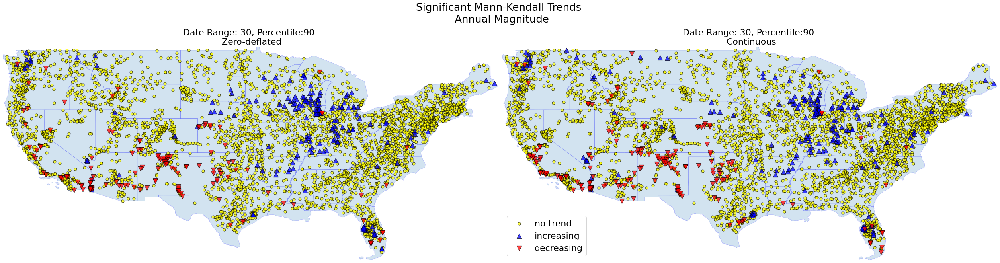

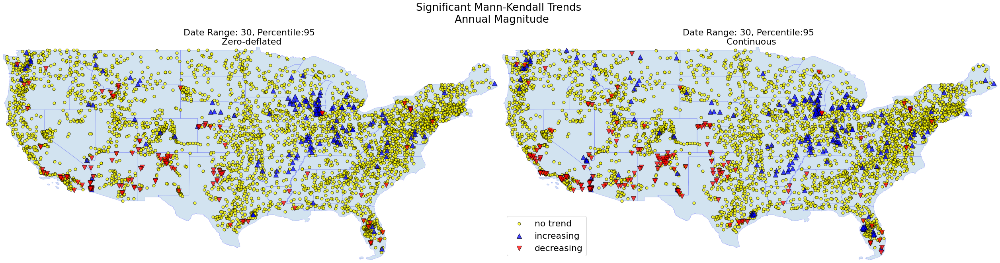

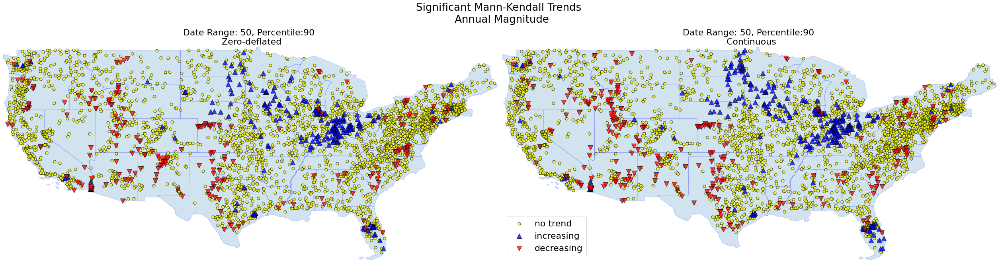

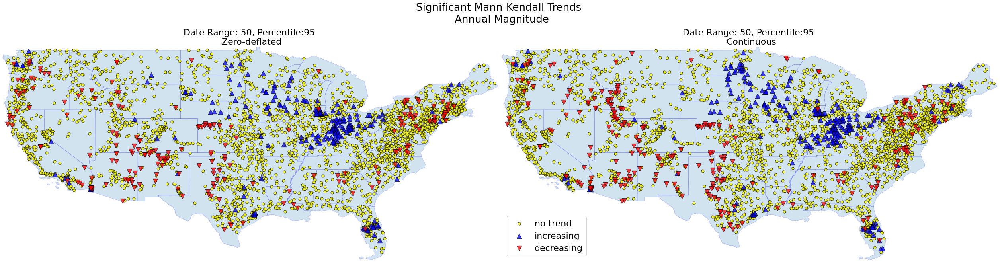

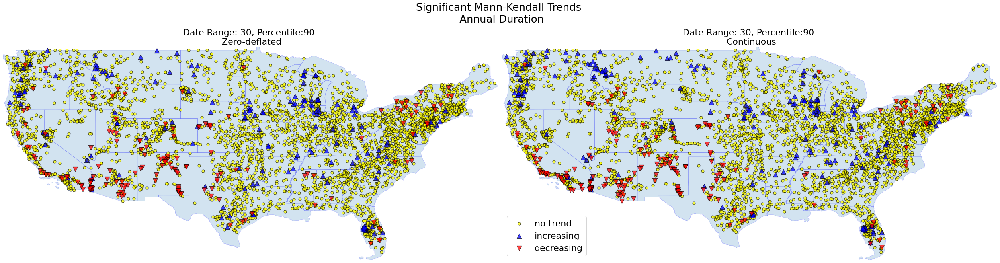

...

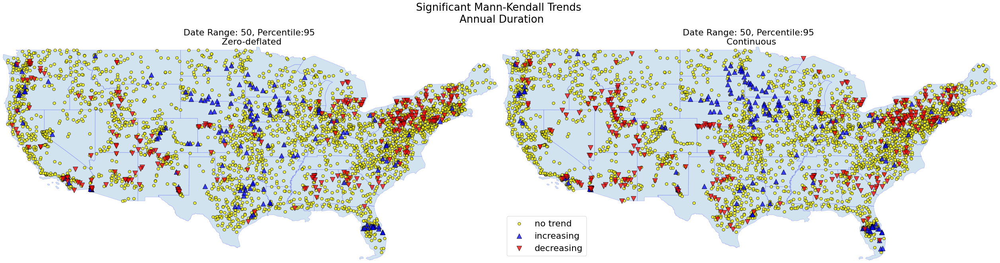

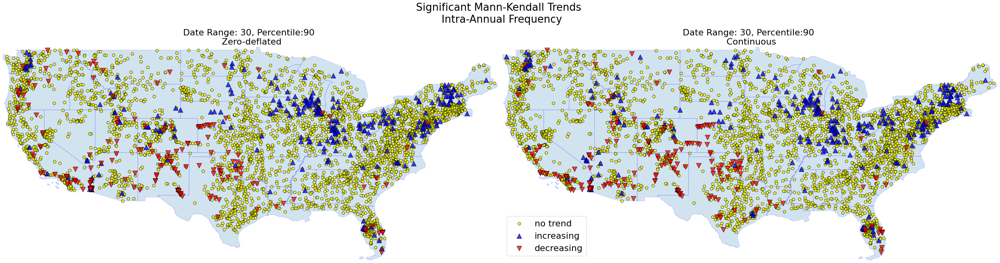

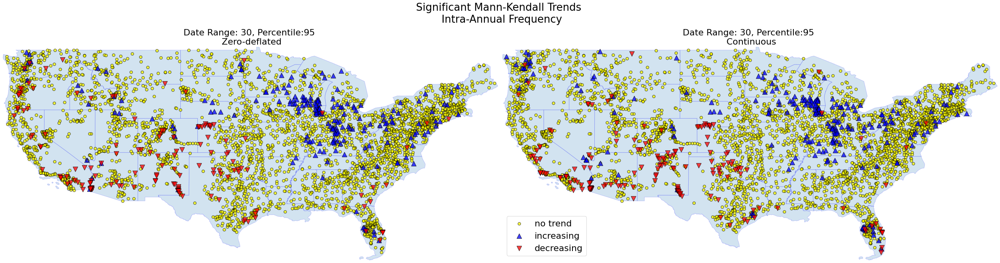

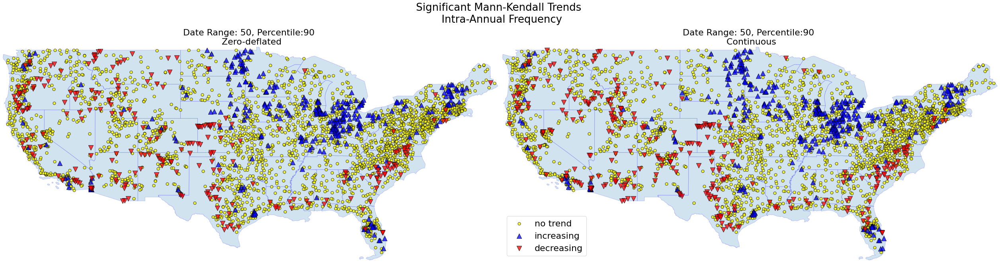

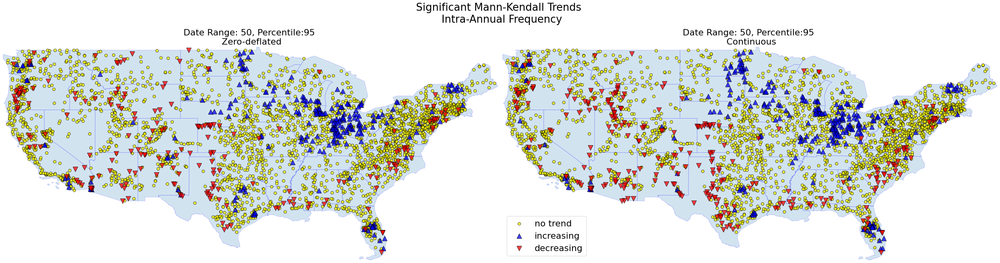

In [27]:
sheet_names = ['mk_magnitude', 'mk_duration','mk_intra_annual']
date_ranges = ['30', '50']
percentiles = ['90', '95']
for sheet_name in sheet_names:
    for date_range in date_ranges:
        for percentile in percentiles:
            plot_mkt_trend(sheet_name=sheet_name, gages_included='valid_gages', date_range=date_range, percentile=percentile)

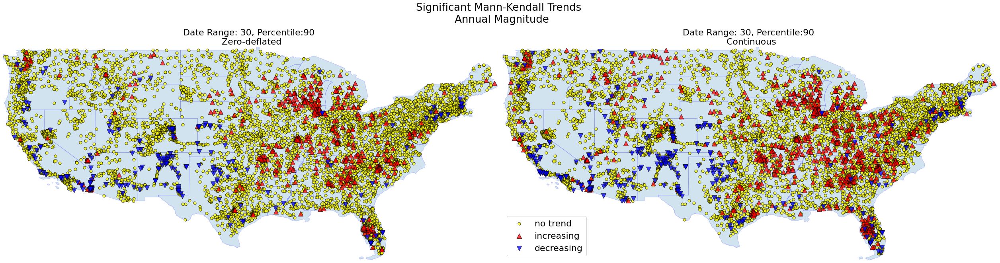

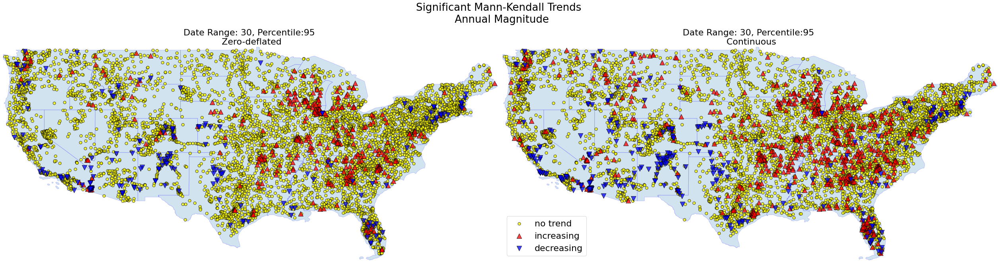

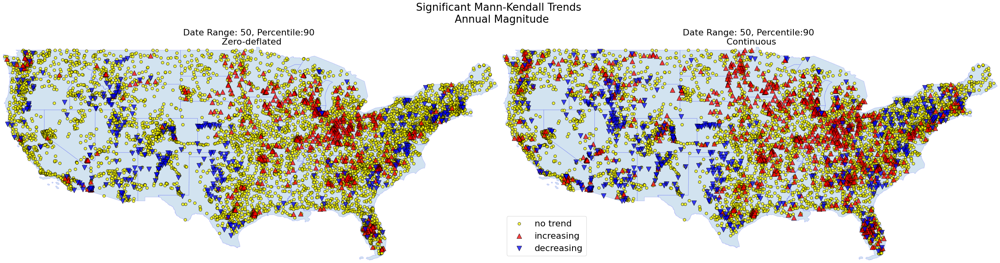

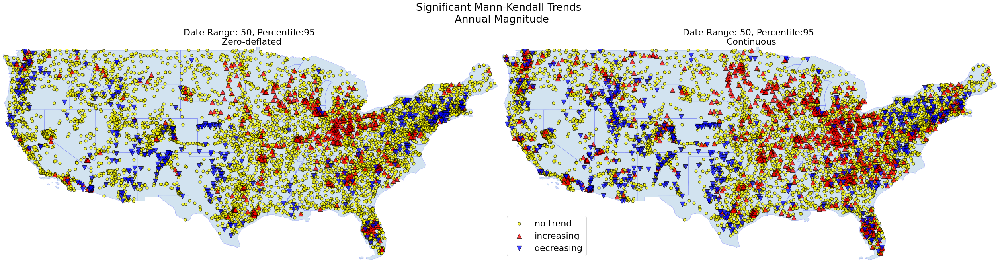

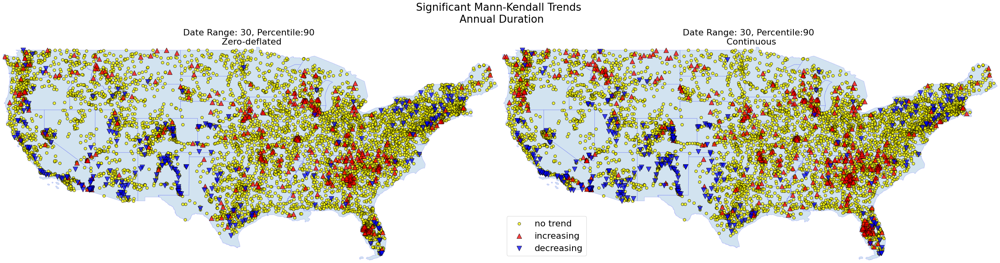

...

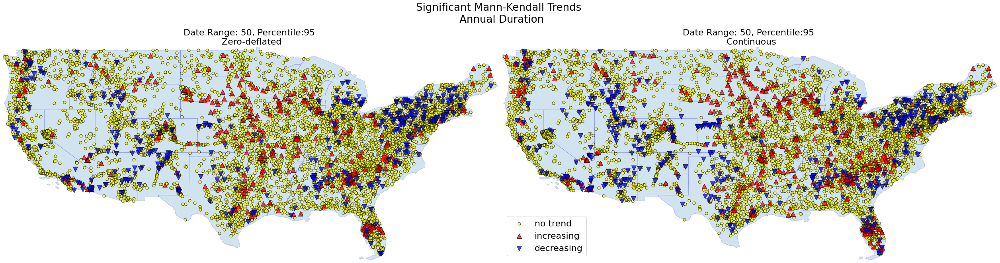

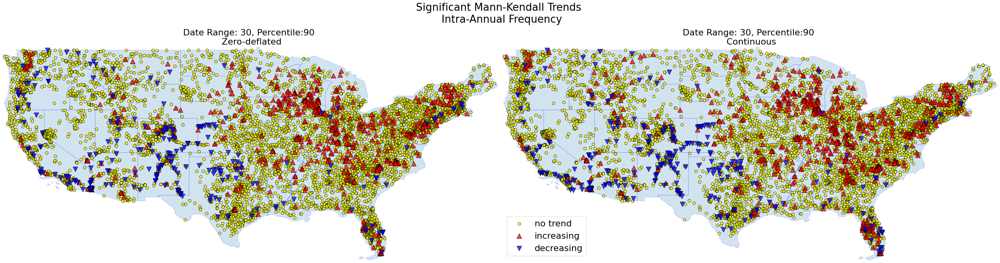

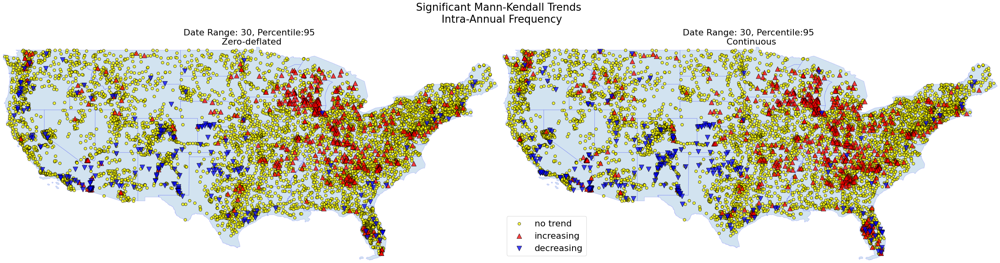

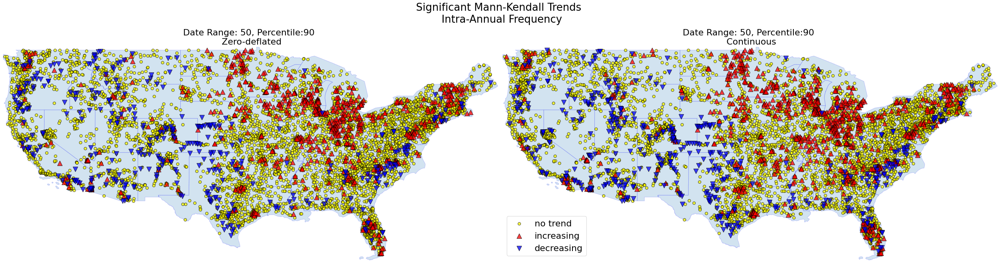

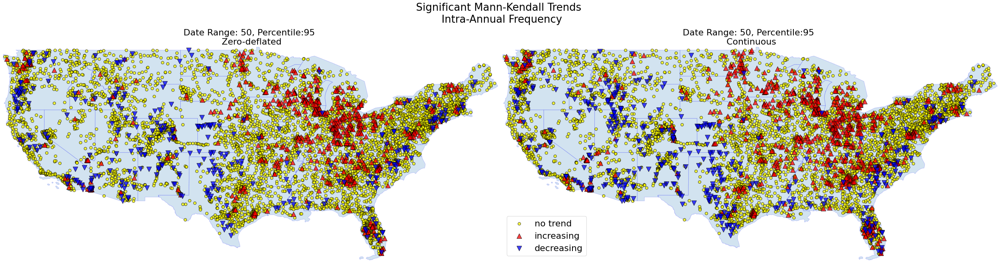

In [109]:
sheet_names = ['mk_magnitude', 'mk_duration','mk_intra_annual']
date_ranges = ['30', '50']
percentiles = ['90', '95']
for sheet_name in sheet_names:
    for date_range in date_ranges:
        for percentile in percentiles:
            plot_mkt_trend(sheet_name=sheet_name, gages_included='all_gages', date_range=date_range, percentile=percentile)

In [16]:
# Load CA map
# USA
shapefile_path = 'C:\\Users\\kondr\\Documents\\Coding\\Python\\maps\\us_states\\tl_2022_us_state.shp'
states = gpd.read_file(shapefile_path)
states = states.to_crs(epsg=4269)
#states.plot()
#plt.show()

# Continental USA
non_continental = ['HI','VI','MP','GU','AK','AS','PR']
us49 = states
for n in non_continental:
    us49 = us49[us49.STUSPS != n]
    
# CA
ca = us49.loc[us49['STUSPS'] == 'CA']
ca = ca.to_crs(epsg=4269)

ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']


C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']


C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']


C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']


C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WB

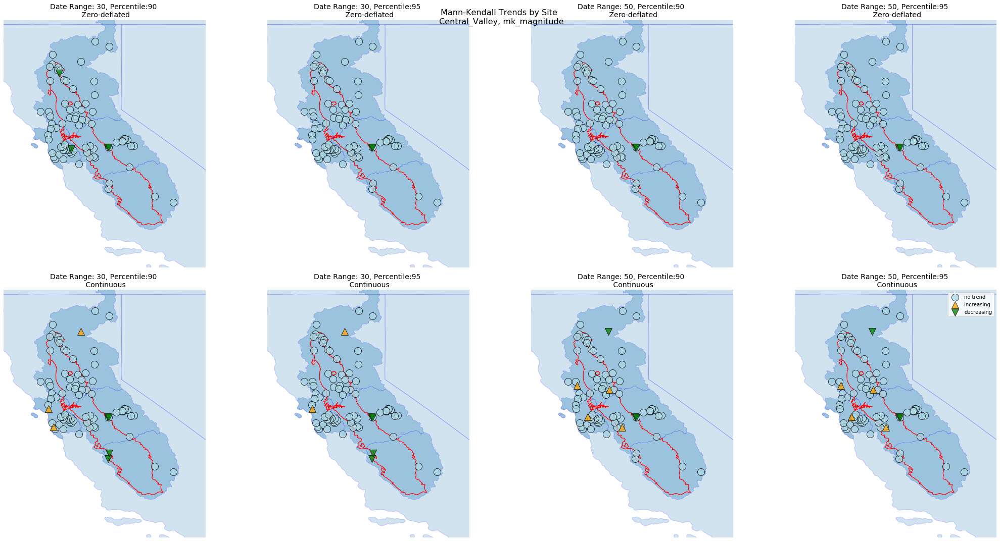

ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WB

C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WB

C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WB

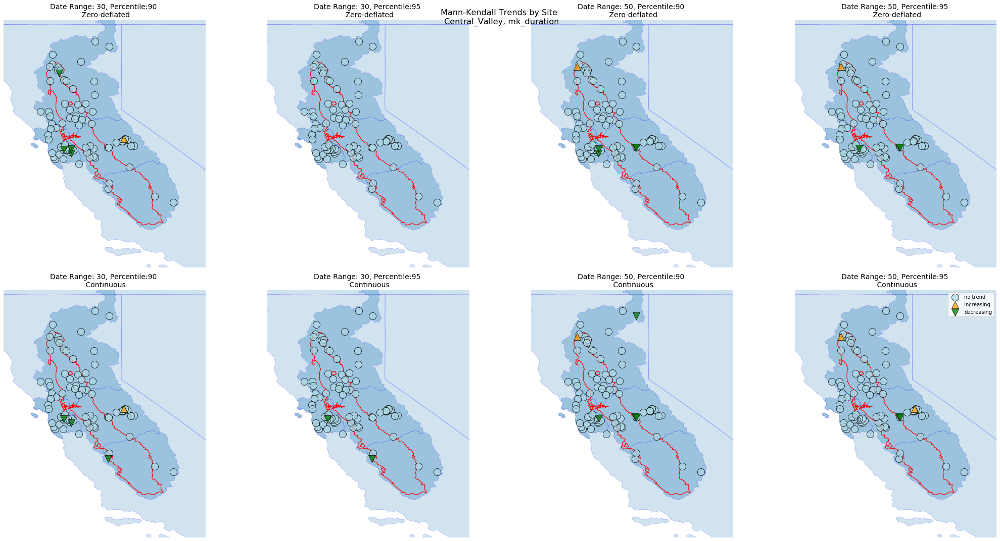

ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WB

C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WB

C:\Users\kondr\anaconda3\lib\site-packages\geopandas\plotting.py:487: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1804 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1805 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\x_NHD_H_1809 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4 ['NHD_H_1802', 'NHD_H_1803', 'NHD_H_1804', 'NHD_H_1805', 'x_NHD_H_1809'] []
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1802 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WBDHU4.shx']
ShapeFiles/Aquifers/Central_Valley/HUC4\NHD_H_1803 [] ['WBDHU4.dbf', 'WBDHU4.prj', 'WBDHU4.shp', 'WB

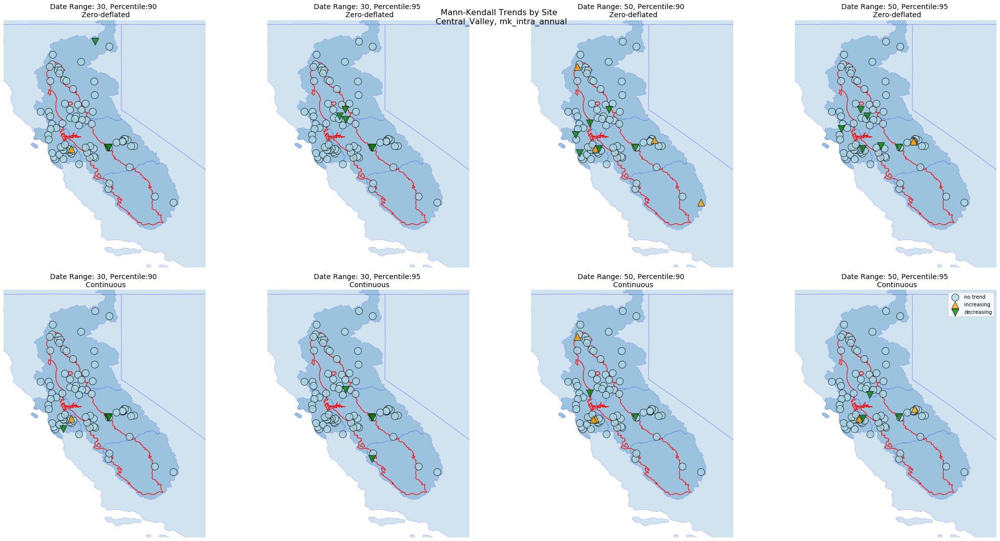

In [17]:
# Mapping trends

# Set the aquifer to collect data for
curr_aquifer = cl.central_valley_aquifer
aquifer= 'Central_Valley'
#curr_aquifer = cl.high_plains_aquifer
#aquifer = 'High_Plains'

trend_options = ['no trend', 'increasing', 'decreasing']

def plot_mkt_trend(aquifer, sheet_name):
    '''Plot map of stream gages and corresponding trend (increasing, decreasing, no trend) for each aquifer. '''
    
    trend_series = ['trend_zd', 'trend']
    trend_label = ['Zero-deflated', 'Continuous']
    date_ranges = ['30', '50']
    percentiles = ['90', '95']
    
    fig, ax = plt.subplots(nrows=2, ncols=4, figsize=(30, 15))
    
    i = 0
    for trend in trend_series:
        j = 0
        for date_range in date_ranges:
            for percentile in percentiles:
                
                # Load data sets based on aquifer, date_range, and percentile
                mkdataset = f'{aquifer}_{date_range}_{percentile}.xlsx'
                datapath = f'../results/site_metrics/{aquifer}/{mkdataset}'
 
                if os.path.exists(datapath):
                    df_aq_sites = pd.read_excel(io=datapath, sheet_name='site_metrics')
                    df_mk = pd.read_excel(io=datapath, sheet_name=sheet_name)

                # REQUIRES: df_aq_sites either from Data Creation or multi_site.csv
                plt.suptitle(f'Mann-Kendall Trends by Site \n {aquifer}, {sheet_name}', fontsize=16)
                             
                #### State plot
                us49.plot(ax=ax[i,j], edgecolor='blue', alpha = 0.2, legend=True) 
                
                # Watershed (HUC4s) plot
                for root, dirs, files in os.walk(curr_aquifer.wb_dir):
                    print(root, dirs, files)
                    if os.path.basename(root).startswith('NHD_H_'):
                        if curr_aquifer.wb_shapefiles in files:
                            shapefile_aq_path = os.path.join(root, curr_aquifer.wb_shapefiles)
                            ws_gdf = gpd.read_file(shapefile_aq_path)
                            ws_gdf = ws_gdf.to_crs(epsg=4269)
                            ws_gdf.plot(ax=ax[i,j], edgecolor='blue', alpha=0.30, linewidth=0.5)

                # Aquifer boundary plot
                aq_gdf = gpd.read_file(curr_aquifer.aq_shapefile)
                aq_gdf = aq_gdf.to_crs(epsg=4269)
                aq_gdf.plot(ax=ax[i,j], edgecolor='red', facecolor='none', linewidth=1.25)

                # Set boundaries around aquifer
                xmin, ymin, xmax, ymax = aq_gdf.total_bounds
                padding = 1.5
                xmin -= padding
                ymin -= padding
                xmax += padding
                ymax += padding

                ax[i,j].set_xlim(xmin, xmax)
                ax[i,j].set_ylim(ymin, ymax)
                
                # Custom colormap and marker styles
                colors = {'increasing': 'orange', 'decreasing': 'green', 'no trend': 'lightblue'}
                markers = {'increasing': '^', 'decreasing': 'v', 'no trend': 'o'}
                

                # Gages plot, with points marked by MK trend
                lat = df_aq_sites['dec_lat_va'].tolist()
                long = df_aq_sites['dec_long_va'].tolist()
                geometry = [Point(xy) for xy in zip(long, lat)]
                geo_df = gpd.GeoDataFrame(geometry=geometry)
                
                for trend_opt in trend_options:
                    df_subset = df_mk[df_mk[trend] == trend_opt]
                    geo_subset = geo_df.iloc[df_subset.index]
                    #print(colors[trend_opt]); color=str(colors[trend_opt]),
                    bx = geo_subset.plot(ax=ax[i,j], color=colors[trend_opt], marker=markers[trend_opt], markersize=200, label=trend_opt, edgecolor='black', linewidth=1, alpha=0.75, legend=True)

                # Set colorbar limits and theme using undivided dataset so that scale is static
                vmin = None
                vmax = None

                #cbx = plt.colorbar(mappable, cax=cax, pad=0.05, aspect=25, orientation='horizontal', alpha=1.0)
                #cbx.set_label('Annual HMF ($\mathregular{km^3}$/year)')

                ax[i,j].set_title(f'Date Range: {date_range}, Percentile:{percentile} \n {trend_label[i]}', fontsize=14)
               # if j == 0:
               #     ax[i,j].set_ylabel(f'{trend_series}')
                ax[i,j].margins(0, tight=True)
                ax[i,j].set_axis_off()
                #cx.add_basemap(ax, crs=aq_gdf.crs, source=cx.providers.OpenStreetMap.Mapnik, zoom=7)
                             
                j += 1
        i += 1

#         img_str = f'../saved_visuals/{dataset[:-4]}.png'
#         if os.path.exists(img_str) and overwrite:
#             plt.savefig(f'../saved_visuals/{aquifer}_{sheet_name}.png')
#         elif not os.path.exists(img_str):
#             plt.savefig(f'../saved_visuals/{aquifer}_{sheet_name}.png')
    
    plt.legend()
    plt.tight_layout()
    plt.savefig(f'../results/saved_visuals/{aquifer}/mkt_maps_{aquifer}_{sheet_name}.png', bbox_inches='tight')
    plt.show()
    return

sheet_names = ['mk_magnitude', 'mk_duration','mk_intra_annual']
#for aquifer in aquifer_list:
for sheet_name in sheet_names:
    plot_mkt_trend(aquifer, sheet_name)